# 03_image_annotation_workspace -- 2022-08-14-unlabeled yale fossils dataset.ipynb

Load previously formatted & serialized image data panel from disk & perform various sort & filtering tasks in order to manually annotate individual rows based on inspection, logging versioned annotation revisions.

Created by: Jacob A Rose  
Created on: Monday August 14th, 2022  
Updated on: Monday September 19th, 2022  

In [1]:
#!pip3 install torchshow

from IPython.display import display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', 500)
pd.set_option('display.float_format', "{:,.2f}".format)

from rich import print as pp
import meerkat as mk
display_res = 1024
# print(mk.config.DisplayOptions.max_image_width)
mk.config.display.max_rows = 100
mk.config.display.max_image_width = display_res
mk.config.display.max_image_height = display_res

# mk.config.DisplayOptions.max_rows = 100
# mk.config.DisplayOptions.max_image_width = display_res
# mk.config.DisplayOptions.max_image_height = display_res

# print(f"{mk.config.DisplayOptions.max_image_width=}")
print("mk.config.display=")
pp(dict(vars(mk.config.display)))

mk.config

mk.config.display=


{'max_rows': 100, 'show_images': True, 'max_image_height': 1024, 'max_image_width': 1024, 'show_audio': True}

MeerkatConfig(display=DisplayConfig(max_rows=100, show_images=True, max_image_height=1024, max_image_width=1024, show_audio=True), datasets=DatasetsConfig(root_dir='/home/jrose3/.meerkat/datasets'))

In [2]:
%load_ext autoreload
%autoreload 2

import os
import numpy as np
from typing import *
import inspect
from tqdm.auto import tqdm
from pathlib import Path
import logging

from PIL import Image
import PIL
from PIL.ImageStat import Stat

import cv2
import glob
from joblib import Parallel, delayed

In [3]:
# from itables import init_notebook_mode
# init_notebook_mode(all_interactive=True)

## Functions

In [4]:
import cv2
import numpy as np
import PIL
import PIL.Image


def rescale_image(img: np.ndarray, max_size: int=512) -> np.ndarray:
    h, w, c = img.shape
    scale = min([max_size/h, max_size/w])
    output_size = int(scale*w), int(scale*h)
    
    return cv2.resize(img, output_size, interpolation=cv2.INTER_AREA)

def rescale_image_PIL(img: PIL.Image.Image, max_size: int=512) -> PIL.Image:
    # print(img)
    # img.load()
    w, h = img.width, img.height
    scale = max([max_size/w, max_size/h])
    output_size = int(scale*w), int(scale*h)
    
    return img.resize(output_size, resample=PIL.Image.Resampling.BICUBIC)



import cv2


def hconcat_resize_min(im_list, interpolation=cv2.INTER_CUBIC):
    h_min = min(im.shape[0] for im in im_list)
    im_list_resize = [cv2.resize(im, (int(im.shape[1] * h_min / im.shape[0]), h_min), interpolation=interpolation)
                      for im in im_list]
    return cv2.hconcat(im_list_resize)

import math
from pathlib import Path

def image_grid(image_paths, 
               col: int=5,
               max_imgs: int=-1,
               include_filenames_as_titles=False):
    
    if max_imgs > 0:
        image_paths = image_paths[:max_imgs]
    
    image_count = len(image_paths)
    row = math.ceil(image_count/col)
    fig = plt.figure(figsize=(col*4,row*4))

    for i, img_path in enumerate(image_paths):
        img_path = str(img_path)

        img = plt.imread(img_path)

        ax = plt.subplot(row, col, i + 1)
        plt.imshow(img)
        if include_filenames_as_titles:
            plt.title(Path(img_path).name)

        # ax.set_xticklabels([])
        # ax.set_yticklabels([])

        plt.axis("off")
    plt.subplots_adjust(wspace=0, hspace=0, top=0.97)
    return fig



In [5]:
def is_empty(path):
    """
    Returns True if the input path is an empty directory, False if anything's in it. Throws an error if target isn't a directory.
    
    """
    
    return len(os.listdir(path)) == 0

def get_version_from_path(path: str) -> int:
    path = Path(path).stem
    return int(path.split("_")[1])



def get_latest_version(root_dir: str,
                       skip_version_if_exists: bool=False) -> Path:
    """
    
    Input a root dir, and this function will either create & return a new subdir labeled "version_0", or it will find the latest created version that doesn't have any files in it.
    
    Should run once in an experiment & save in a variable if need to reference version elsewhere in script.
    
    root_dir: str
        Location in which multiple version subdirs will be located (e.g. "./version_{0,1,2,3...}"
    skip_version_if_exists: bool, default=False
        If False, attempt to load previous annotations if found on disk. If True, always go to the next version number if version subdir is not empty.
        By default, attempts to load previous annotations if they exist.
    
    """
    v = 0
    if not is_empty(root_dir):
        for d in sorted(os.listdir(root_dir)):
            v = max([v, get_version_from_path(d)])
            if (
                skip_version_if_exists
                and (not is_empty(Path(root_dir, d)))
            ):
                v = get_version_from_path(d) + 1

    save_dir = Path(root_dir, f"version_{v}")
    os.makedirs(save_dir, exist_ok=True)
    
    return save_dir

### Functions for caching annotations

* Functions to load (`load_cached_annotations` and save (`cache_annotations`) versioned catalogs of annotated/labeled datasets to iteratively work through a large set in many small increments.

* Saves an `annotated_df` and a `non_annotated_df` containing the same columns, with the latter having NaN for all values of the `label` column.

In [6]:
from typing import *


def cache_annotations(save_dir: str,
                      annotated_df: pd.DataFrame,
                      non_annotated_df: pd.DataFrame
                     ) -> None:
    """
    Save 2 different dataframes into a cache directory as parquet & csv files.
    
    The 1st contains only rows that have been manually annotated at least once.
    The 2nd contains only rows that have never been annotated (indicated by a value of label=="")
    """
    annotations_cache_dir = Path(save_dir, "annotations_cache")
    os.makedirs(annotations_cache_dir, exist_ok=True)

    annotated_df.to_parquet(annotations_cache_dir / f"annotated.parquet")
    annotated_df.to_csv(annotations_cache_dir / f"annotated.csv")
    annotated_df.describe(include='all').to_csv(annotations_cache_dir / "annotated_summary.csv")

    non_annotated_df.to_parquet(annotations_cache_dir / f"non_annotated.parquet")
    non_annotated_df.to_csv(annotations_cache_dir / f"non_annotated.csv")
    non_annotated_df.describe(include='all').to_csv(annotations_cache_dir / "non_annotated_summary.csv")
    
    
def load_cached_annotations(
    save_dir: str
) -> Tuple[Any]:
    """
    Load 2 different dataframes from a cache directory from either parquet or csv files.
    
    The 1st contains only rows that have been manually annotated at least once.
    The 2nd contains only rows that have never been annotated (indicated by a value of label=="")
    """
    annotations_cache_dir = Path(save_dir, "annotations_cache")
    if not os.path.isdir(annotations_cache_dir):
        return None, None
    
    
    if os.path.isfile(annotations_cache_dir / f"annotated.parquet"):
        annotated_df = pd.read_parquet(annotations_cache_dir / f"annotated.parquet")
    else:
        annotated_df = pd.read_csv(annotations_cache_dir / f"annotated.csv", index_col=0)

    if os.path.isfile(annotations_cache_dir / f"non_annotated.parquet"):
        non_annotated_df = pd.read_parquet(annotations_cache_dir / f"non_annotated.parquet")
    else:
        non_annotated_df = pd.read_csv(annotations_cache_dir / f"non_annotated.csv", index_col=0)


    return annotated_df, non_annotated_df

## Specify & Load dataset

### Define key file info & metadata

In [7]:
yale_fossil_dir = "/media/data_cifs/projects/prj_fossils/data/yale_full"

analysis_results_root_dir = "/media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/analysis_results/"
results_filename = "01_image_stats_df"

meerkat_dir = os.path.join(analysis_results_root_dir, "meerkat")
meerkat_path = os.path.join(meerkat_dir, "02b_rich_metadata_embedded_images_meerkat_datapanel")

In [8]:
annotations_dir = "/media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/manual_annotations"
save_dir = get_latest_version(root_dir=annotations_dir)
print(f"Checking for cached annotations in {save_dir}")
pp(f'Loading from: {Path(save_dir).stem.replace("_", " ")}')
# cache_annotations(save_dir=save_dir,
#                   annotated_df=annotated_df,
#                   non_annotated_df=non_annotated_df)


annotated_df, non_annotated_df = load_cached_annotations(save_dir=save_dir)
if (
    isinstance(annotated_df, pd.DataFrame) 
    and isinstance(non_annotated_df, pd.DataFrame)
):
    df = pd.concat([
        non_annotated_df, annotated_df
    ])
    dp = mk.DataPanel.from_pandas(df)
    print(f"Successfully loaded from cache")
else:
    dp = mk.DataPanel.read(meerkat_path)
    print(f"No cache exists, loading raw data")

Checking for cached annotations in /media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/manual_annotations/version_0


Loading from: version 0

Successfully loaded from cache


In [9]:
annotated_df.describe(include='all')
non_annotated_df.describe(include='all')

,label,thumb_path,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,235,235,235,235.00,235.00,235.00,235.00,235.00,235.00,235.00,235.00,235.00,233,229,187,210,217,230,230,233,233,107,107,100,100,97,70,107,46,235,233,98,6,4,235,235,105.00,105.00,105.00,235,235,235,89,235,235,235,233,103,105,105,235,0
unique,3,235,235,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,2,3,20,28,39,67,2,17,3,6,13,16,18,18,25,7,74,35,13,5,3,231,231,NaN,NaN,NaN,231,231,231,9,235,231,10,73,3,17,1,231,0
top,unknown,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:f9a8d819-29a4-49e4-ac2f-12eee9025856.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:385193fa-8fc3-4fe4-b879-630ea1f9e88e.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Gymnospermopsida,Cycadeoidales,Cycadeoidaceae,Cycadeoidea,sp.,Species,tracheophytes; plants,North America,USA,South Dakota,Fall River County,Minnekahta,"4 miles southwest of Minnekahta, middle of patch",North America; USA; South Dakota; Fall River County; Minnekahta,Lakota Fm,Cycadeoidea sp.,Plantae; Tracheophyta; Gymnospermopsida; Cycadeoidales; Cycadeoidaceae,Early Cretaceous,Late Eocene,Maastrichtian,Psaronius conjugatus (YPM PB 035827),http://collections.peabody.yale.edu/search/Record/YPM-PB-035827,NaN,NaN,NaN,urn:uuid:14829c3f-26bb-4ba1-be6b-6808c34b6527,YPM PB 035827,Sectioned trunk of a tree fern. Central vascular portion and enclosing root mass.; PB number 35827; lot count 1,H. F. Wells,urn:uuid:5ed8f2ef-1a27-439c-aab3-233ae1744544,urn:uuid:14829c3f-26bb-4ba1-be6b-6808c34b6527,2022-03-09T21:55:46.000Z,Cycadeoidea sp.,Dylan Young,5/5/2015,GEOLocate,"{ ""irn"": ""768886"", ""media"": ""409256:541e2bc8-fdc9-4254-b8e2-d11f1f9fec84 409257:44316add-5edc-4bd4-ab31-af0f0dd7af0b 531532:a59be105-025f-4ede-80d0-da9e673a1a63 531533:c8fd68e3-39f0-44d0-8c0a-8faf35882199"", ""mm_repository_id"": ""409256"", ""solr_long_lat"": ""12.91995,50.8292"" }",NaN
freq,110,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,233,228,181,177,177,172,35,230,188,98,92,69,62,59,19,59,32,32,177,68,2,2,3,3,NaN,NaN,NaN,3,3,3,60,1,3,183,32,89,68,105,3,NaN
mean,NaN,NaN,NaN,235.12,230.12,213.23,38.09,30.71,237.95,"4,755.94","5,907.33",0.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.90,-92.90,"19,277.08",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,8.22,9.34,17.82,25.82,16.88,5.77,"1,686.53","2,348.84",0.35,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.48,29.68,"55,734.41",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,211.40,191.78,122.33,4.31,4.53,228.74,419.00,477.00,0.61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-33.00,-113.17,80.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,230.34,224.00,202.06,24.81,17.79,232.99,"4,000.00","4,000.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.39,-103.75,"3,036.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,235.45,231.03,214.64,31.30,29.15,237.69,"4,000.00","6,000.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.43,-103.69,"5,828.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,240.80,237.24,225.71,43.30,39.47,242.49,"6,000.00","6,000.00",0.79,NaN,N

,label,thumb_path,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,16209,16209,16209,"16,209.00","16,209.00","16,209.00","16,209.00","16,209.00","16,209.00","16,209.00","16,209.00","16,209.00",16170,15282,4822,13717,8882,15209,14081,16170,16170,13829,13874,13231,12136,12005,5847,13874,10794,16208,16170,13330,7255,8310,16209,16209,"13,737.00","13,737.00","13,653.00",16209,16209,16209,12221,16209,16209,16209,16170,12899,13650,13670,16209,4
unique,1,16209,16209,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,14,26,86,188,647,1294,11,82,5,31,62,191,358,371,483,115,2036,274,55,43,65,14937,14937,NaN,NaN,NaN,14937,14937,12839,195,16209,14937,2146,2097,8,102,5,14937,2
top,,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:38886010-8e7d-499e-b174-0faab01262aa.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:6baf59a9-d48d-4838-8886-28d9a59499d9.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Lycopsida,Marattiales,Calamitaceae,Pecopteris,sp.,Species,tracheophytes; plants,North America,USA,Illinois,Grundy County,Mazon Creek,Woodbridge Clay; Amboy Clays,North America; USA; Illinois; Grundy County; Mazon Creek,Carbondale Fm,Pecopteris sp.,Plantae; Tracheophyta; Marattiales,Middle Pennsylvanian,Carboniferous,Desmoinesian,Annularia sphenophylloides (YPM PB 003129),http://collections.peabody.yale.edu/search/Record/YPM-PB-000678,NaN,NaN,NaN,urn:uuid:151b2fe9-2a06-4506-a078-4e7511db9287,YPM PB 003129,leaf; PB number 73504; lot count 1; accn=YPM.10426,Samuel S. Strong,urn:uuid:e221942e-556d-4e7f-8d70-ee69e3462b9e,urn:uuid:151b2fe9-2a06-4506-a078-4e7511db9287,2020-10-03T14:18:59.000Z,Pecopteris sp.,Dylan Young,2/4/2015,GEOLocate,"{ ""irn"": ""738576"", ""media"": ""409243:87c656ad-ac16-4d0c-a3db-8ef31d5785c4 409244:1d95fc39-73cc-4e48-b302-23db440e3103 531497:8f24a4e7-add9-48d2-90f5-30691dee0d6a 531498:4de61ab7-9025-4fbf-946d-ec0c9ed25cf6 840794:7be84dbb-d7c4-4b98-a574-7d6f88c4e49d"", ""mm_repository_id"": ""409243"" }",image file is truncated (0 bytes not processed)
freq,16209,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16136,15167,1745,4206,1720,4166,6412,13890,10637,13158,12756,4894,4856,4841,423,4841,4855,3540,4190,5035,4603,4848,5,5,NaN,NaN,NaN,5,5,6,4773,1,5,5202,3522,11788,4885,13574,5,3
mean,NaN,NaN,NaN,138.53,111.65,78.50,31.52,118.93,138.90,"2,645.96","2,832.20",1.01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.72,-87.57,"22,943.35",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,34.63,32.56,33.72,18.13,44.61,34.74,"1,046.97","1,114.58",0.44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.08,24.34,"138,034.16",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,18.64,18.24,9.78,4.42,4.36,19.68,198.00,284.00,0.11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-49.05,-151.53,80.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,115.77,90.14,56.04,21.88,89.76,116.02,"1,988.00","2,039.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.48,-98.20,"2,929.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,140.85,111.10,71.69,25.34,126.15,141.19,"2,586.00","2,990.00",0.86,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.29,-88.42,

In [10]:
cols = dp.columns
dp = dp.sort(by="v", ascending=False)

In [11]:
image_record_cols = [
    'thumbnail',
    'thumb_path',
    'path'
]


stats_cols = [    
    # 'thumbnail',
    'thumb_path',
    'path',
    'r',
    'g',
    'b',
    'h',
    's',
    'v',
    'height',
    'width',
    'aspect_ratio'
]

geo_cols = [
    # 'thumbnail',
    'thumb_path',
    'path',
    'kingdom',
    'phylum',
    'class',
    'order',
    'family',
    'genus',
    'specificEpithet',
    'taxonRank',
    'vernacularName',
    'continent',
    'country',
    'stateProvince',
    'county',
    'municipality',
    'locality'
]

column_groups = [
    "image_record_cols",
    "stats_cols",
    "geo_cols"
]



options=[
    'Fossil Leaf', 
    'Cleared Leaf',
    'other', 
    'unknown',
    ''
    ]

## Main Interface: Annotation Widget

In [12]:
df = non_annotated_df.sort_values("v", ascending=False)

pp(f"Skipping a total of {len(annotated_df)} previously annotated samples distributed as follows:")
annotated_df.value_counts("label")

pp(f"Beginning the continued annotation process on the remaining {len(non_annotated_df)} samples")

Skipping a total of 235 previously annotated samples distributed as follows:

label
unknown         110
Fossil Leaf      91
Cleared Leaf     34
dtype: int64

Beginning the continued annotation process on the remaining 16209 samples

In [13]:
def display_fn(filename: str, **kwargs):
    f = open(filename, "rb").read()
    return Image(value=f, format=Path(filename).suffix.strip("."), **kwargs)

In [14]:
# df.value_counts("label")
# import pandas as pd
# import pigeonXT as pixt

from IPython.display import display#, Image
from ipywidgets import Image

# df = dp.to_pandas()
# df.index.name = "idx"
# df = df.reset_index()

# ddf = annotated_df
# ddf.columns
# ddf.value_counts('label')
# ddf.value_counts('aspect_ratio')
# non_annotated_df.value_counts('aspect_ratio')

In [15]:
# import seaborn as sns
# sns.histplot(non_annotated_df, x='aspect_ratio')
# sns.histplot(annotated_df, x='aspect_ratio')

In [16]:
df = pd.concat([annotated_df, non_annotated_df])
df.describe(include='all')

,label,thumb_path,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,16444,16444,16444,"16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00",16403,15511,5009,13927,9099,15439,14311,16403,16403,13936,13981,13331,12236,12102,5917,13981,10840,16443,16403,13428,7261,8314,16444,16444,"13,842.00","13,842.00","13,758.00",16444,16444,16444,12310,16444,16444,16444,16403,13002,13755,13775,16444,4
unique,4,16444,16444,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,14,26,87,197,663,1313,11,84,5,31,62,191,358,372,483,115,2065,286,55,43,65,15158,15158,NaN,NaN,NaN,15158,15158,13060,195,16444,15158,2146,2126,8,102,5,15158,2
top,,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:38886010-8e7d-499e-b174-0faab01262aa.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:6baf59a9-d48d-4838-8886-28d9a59499d9.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Lycopsida,Marattiales,Calamitaceae,Pecopteris,sp.,Species,tracheophytes; plants,North America,USA,Illinois,Grundy County,Mazon Creek,Woodbridge Clay; Amboy Clays,North America; USA; Illinois; Grundy County; Mazon Creek,Carbondale Fm,Pecopteris sp.,Plantae; Tracheophyta; Marattiales,Middle Pennsylvanian,Carboniferous,Desmoinesian,Annularia sphenophylloides (YPM PB 003129),http://collections.peabody.yale.edu/search/Record/YPM-PB-000678,NaN,NaN,NaN,urn:uuid:151b2fe9-2a06-4506-a078-4e7511db9287,YPM PB 003129,leaf; PB number 73504; lot count 1; accn=YPM.10426,Samuel S. Strong,urn:uuid:e221942e-556d-4e7f-8d70-ee69e3462b9e,urn:uuid:151b2fe9-2a06-4506-a078-4e7511db9287,2020-10-03T14:18:59.000Z,Pecopteris sp.,Dylan Young,2/4/2015,GEOLocate,"{ ""irn"": ""752195"", ""media"": ""118643:12408226-9320-4f7a-a7e2-17a3adac29b0 409249:f4e2b2d6-760a-4c17-99f2-5e2569ce0fdb 409250:ce99f233-131b-49bb-81c0-6dc0975f3ec6 531517:72ce917f-02fb-44dc-89c8-c1b9e9b7707d 531518:88b9a546-55be-4f52-8eb6-e35e0e593420"", ""mm_repository_id"": ""118643"", ""solr_long_lat"": ""-80.475622,40.798952"" }",image file is truncated (0 bytes not processed)
freq,16209,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16369,15395,1745,4210,1720,4167,6447,14120,10825,13256,12848,4895,4857,4842,423,4842,4856,3541,4194,5036,4604,4849,5,5,NaN,NaN,NaN,5,5,6,4774,1,5,5202,3523,11877,4886,13679,5,3
mean,NaN,NaN,NaN,139.91,113.34,80.43,31.61,117.67,140.32,"2,676.11","2,876.15",1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.74,-87.61,"22,915.37",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,36.26,35.27,37.16,18.28,45.56,36.45,"1,087.97","1,198.44",0.44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.07,24.39,"137,592.11",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,18.64,18.24,9.78,4.31,4.36,19.68,198.00,284.00,0.11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-49.05,-151.53,80.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,116.13,90.47,56.28,21.89,87.46,116.48,"1,988.00","2,053.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.48,-98.20,"2,929.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,141.51,111.54,72.13,25.40,125.38,141.89,"2,612.00","2,990.00",0.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [17]:
# sns.histplot(df, x='stateProvince', kde=True)

# rb_df = df.sort_values("recordedBy")
# rb_df.value_counts("recordedBy")

# import ipyplot
# ipyplot.plot_class_representations(images, labels, img_width=150)
# rb_df.columns

# images = rb_df.thumb_path.values.tolist()
# labels = rb_df.

# I. EDA & metadata-guided analysis based on `recordedBy` and `country` columns

## Inspect `recordedBy` column

    * Sort df by value of `recordedBy` column

### A. Create na-contribution, single-contribution & multi-contribution partitions of the dataset
- by dividing samples between  
    i. those with NaN values for `recordedBy`  
    ii. those from contributors with only 1 included specimen  
    iii. and those from contributors with 2 or more,  
respectively.

* **Goal**: Looking for unique patterns that often result from a single source
* **Note**: all rows with NaN values in `recordedBy` column are included in the single_contrib collection

In [18]:
import ipyplot

In [19]:
rb_df = df.sort_values("recordedBy")#.head(10)
v_counts = rb_df.value_counts("recordedBy")

v_counts = v_counts[v_counts>1]

# `values` are the recordedBy names that satisfy the test condition: having more than 1 specimen.
values = v_counts.index.values

multi_contrib = rb_df[rb_df.recordedBy.apply(lambda x: x in values) & ~rb_df.recordedBy.isna()]
single_contrib = rb_df[rb_df.recordedBy.apply(lambda x: x not in values) & ~rb_df.recordedBy.isna()]

na_contrib = rb_df[rb_df.recordedBy.isna()]

print(f"{multi_contrib.shape=}, {single_contrib.shape=}, {na_contrib.shape=}")

assert single_contrib.recordedBy.isna().sum() == 0
assert multi_contrib.recordedBy.isna().sum() == 0
assert na_contrib.recordedBy.isna().sum() == na_contrib.shape[0]


multi_contrib.shape=(12263, 52), single_contrib.shape=(47, 52), na_contrib.shape=(4134, 52)


In [20]:
12263 + 47 + 4134

16444

In [21]:
# single_contrib[single_contrib.recordedBy.isna()].describe(include='all')
# multi_contrib[multi_contrib.recordedBy.isna()]

# labels[labels=="None"]

# labels.isna().sum()#.info()

# labels.iloc[labels.isna()] = "NA"

# labels.value_counts()

# II. Visual Inspection of image groups

## A. Plotting single contributor images in a grid

<!-- * Replace NaN values with a string placeholder of "NA" -->

### (A.0) - display plots

In [22]:
imgs, labels = single_contrib.thumb_path, single_contrib.recordedBy
# labels.iloc[labels.isna()] = "NA"
labels.value_counts().T

ipyplot.plot_class_representations(imgs.values, labels.values, img_width=200)

James G. Mead                                                    1
J. J. Howell                                                     1
John A. Alley                                                    1
Bruce H. Tiffney, Lee S. Pierce                                  1
Lockwood                                                         1
J. A. Smith                                                      1
Marsh Collection                                                 1
Malcolm R. Walter                                                1
Charles R. Zeiller                                               1
Leo J. Hickey, R. Loring, Alexander Gancarz                      1
Daniel Peppe                                                     1
Charles A. Hollick, Edward C. Jeffrey                            1
Charles A. Hollick, H. S. Shimer                                 1
unknown                                                          1
F. S. Page, Carl L. Wilson                                    

In [23]:
labels.shape

(47,)

### (A.1) - Conclusion: 

`0` undesired images out of `47`, all Fossils

In [24]:
## B. Plotting na-contributor images in tabs, grouped by `country`

# na_contrib.shape

# Plotting images by class between tabs

## Looking closely at all rows with NaN values for `recordedBy`, group them by `country`

1. `4,134` out of `16,444` specimens have `NaN` values for `recordedBy`  
2. `92%` of these have either `NaN` (50%) or `USA` (42%) for `country`
3. After manually inspecting all images grouped by country below, all of the countries except `NA`, `USA`, and `Brazil` contain valid entries

In [25]:
## Instantiate a list to keep track of our annotations

marked_for_removal = []

### (B.0) - Inspect low-contribution groups
    * Manually inspect rows with both  
        a. NaN in `recordedBy` column, and  
        b. column `country` value with fewer than 120 rows in total

* Sort values by HSV `v` channel value

In [26]:
# na_contrib = na_contrib.sort_values("v", ascending=False)
na_contrib = na_contrib.sort_values("h", ascending=False)


In [27]:
## 1. Select all rows with `recordedBy` == NaN
# na_recordedBy = rb_df[rb_df.recordedBy.isna()]
# print(f"{rb_df.shape=}, {na_recordedBy.shape=}")

print(f"{rb_df.shape=}, {na_contrib.shape=}")

na_contrib.columns
# na_contrib.describe(include='all')

rb_df.shape=(16444, 52), na_contrib.shape=(4134, 52)


Index(['label', 'thumb_path', 'path', 'r', 'g', 'b', 'h', 's', 'v', 'height',
       'width', 'aspect_ratio', 'kingdom', 'phylum', 'class', 'order',
       'family', 'genus', 'specificEpithet', 'taxonRank', 'vernacularName',
       'continent', 'country', 'stateProvince', 'county', 'municipality',
       'locality', 'higherGeography', 'formation', 'scientificName',
       'higherClassification', 'earliestPeriodOrLowestSystem',
       'earliestEpochOrLowestSeries', 'earliestAgeOrLowestStage',
       'bibliographicCitation', 'references', 'decimalLatitude',
       'decimalLongitude', 'coordinateUncertaintyInMeters', 'occurrenceID',
       'catalogNumber', 'occurrenceRemarks', 'recordedBy', 'identifier', 'id',
       'modified', 'previousIdentifications', 'georeferencedBy',
       'georeferencedDate', 'georeferenceSources', 'dynamicProperties',
       'error'],
      dtype='object')

In [28]:
label_key = 'country'

# imgs, labels = na_contrib.thumb_path, na_contrib.loc[:,label_key]
imgs, labels = na_contrib.thumb_path, na_contrib[label_key]
ids = na_contrib["identifier"]
h, s, v = na_contrib["h"], na_contrib["s"], na_contrib["v"]
#Replace NaN values with string placeholder "NA"
# labels.iloc[labels.isna()] = "NA"
labels = labels.fillna("NA")

# labels.value_counts()

assert ids.value_counts().shape[0] == labels.shape[0]
assert labels.value_counts().sum() == labels.shape[0]

vc_norm = labels.value_counts(True)
vc = labels.value_counts()
pd.concat([vc, vc_norm], axis=1)

tabs_order = labels.value_counts().index.values[::-1]

,country,country
NA,2051,0.50
USA,1720,0.42
Canada,117,0.03
England,60,0.01
Mexico,33,0.01
Germany,27,0.01
Sweden,25,0.01
Poland,22,0.01
China,15,0.00
Italy,11,0.00


#### Plot max=120 images per country's tab to quickly weed out the smaller countries

In [29]:
ipyplot.plot_class_tabs(imgs.values, labels.values, custom_texts=ids.values, max_imgs_per_tab=120, img_width=150, tabs_order=tabs_order)

### (B.0) - Conclusion:
* Saving `USA` and `NA` for the next step, the only low-contribution group with undesirable specimens is `1` row with `recordedBy=NaN` & `country="Brazil"`

In [30]:
idx_to_drop = labels[labels=="Brazil"].index
thumb_paths_to_drop = imgs[idx_to_drop].values.tolist()

thumb_paths_to_drop
assert len(thumb_paths_to_drop) == 1

marked_for_removal.append({
    "thumb_path": thumb_paths_to_drop[0],
    "reason": "Image does not contain a Fossil"
})

['/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:497bb3d0-0b5f-40be-bd53-4f66c110f2ff.jpg']

In [31]:
marked_for_removal

[{'thumb_path': '/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:497bb3d0-0b5f-40be-bd53-4f66c110f2ff.jpg',
  'reason': 'Image does not contain a Fossil'}]

### (B.1) - Inspect high-contribution groups
    * Narrow down to only the 3 countries of interest

1. `NA` - `2,051` specimens need to be reviewed
2. `USA` - `1,720` specimens need to be reviewed
3. `Brazil` - `1` specimen -- patently undesired image based upon manual inspection

In [32]:
# labels.value_counts()

In [33]:
# # Select only specimens from countries with at least `thresh` entries
# thresh = 25
# in_thresh = labels.value_counts() >= thresh
# keep_idx = labels.apply(lambda x: in_thresh[x])
# imgs = imgs[keep_idx.index]
# labels = labels[keep_idx]

#######################
# # Select only specimens from countries in our manually constructed search query
search_query = ["NA", "USA", "Brazil"]
in_query = labels.apply(lambda x: x in search_query)
keep_idx = labels[in_query]

imgs = imgs[keep_idx.index]
labels = labels[keep_idx.index]
ids = ids[keep_idx.index]

h = h[keep_idx.index]
s = s[keep_idx.index]
v = v[keep_idx.index]
###############
###############

imgs.shape
labels.shape
labels.value_counts()#label_key)

(3772,)

(3772,)

NA        2051
USA       1720
Brazil       1
Name: country, dtype: int64

### sort by `v`

In [34]:
sorted_idx = v.sort_values(ascending=False).index.values

imgs = imgs[sorted_idx]
labels = labels[sorted_idx]
ids = ids[sorted_idx]
h = h[sorted_idx]
s = s[sorted_idx]
v = v[sorted_idx]

#### Display the 3 countries of interest

In [35]:
# ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=2500, img_width=200)
# ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=1025, img_width=200)

# start_idx = 400
# end_idx = 1025

start_idx = 0
end_idx = -1



kwargs = {
    "images": imgs.values[start_idx:end_idx],
    "labels": labels.values[start_idx:end_idx],
    "custom_texts": ids[start_idx:end_idx]
}
ipyplot.plot_class_tabs(**kwargs,
                        max_imgs_per_tab=2500, # 1025,
                        img_width=200)

In [36]:
# import cv2
# import matplotlib.pyplot as plt

# img = cv2.imread(file_paths_to_drop[0])
# plt.imshow(img[:,:,::-1])

# rows2drop = rb_df[rb_df.thumb_path.apply(lambda x: x in file_paths_to_drop)]
# identifier2drop = rows2drop.identifier
# identifier2drop

In [37]:
# start_idx = 0
# end_idx = -1

idx = labels[labels=="NA"].index.values

kwargs = {
    "images": imgs[idx].values,
    "labels": labels[idx].values,
    "custom_texts": ids[idx].values
}

kwargs["images"].shape

(2051,)

In [38]:
selected_idx = [
2,
3,
7,
8,
13,
15,
19,
22,
24,
25,
27,
33,
34,
38,
42,
52,
53,
55,
56,
57,
58,
62,
67,
68,
87,
91,
93,
99,
106,
108,
111,
115,
119,
121,
122,
124,
126,
127,
129,
130,
131,
132,
139,
140,
143,
144,
145,
146,
147,
148,
153,
154,
156,
157,
158,
161,
162,
163,
164,
165,
166,
170,
171,
172,
174,
175,
176,
177,
178,
181,
183,
188,
189,
190,
191,
192,
193,
194,
195,
196,
197,
198,
199,
204,
208,
209,
210,
213,
225,
231,
235,
260,
263,
289,
318,
550,
664,
1561
]

In [39]:
kwargs = {k: v[selected_idx] for k, v in kwargs.items()}
kwargs['images'].shape

(98,)

In [40]:
marked_for_removal.extend(
    [
        {
            "thumb_path": path,
            "reason": "Specimen image appears not to be a Fossil, found by manual inspection after filtering for rows with NaN values in `recordedBy`, then rows with NaN values in `country`, then sorting by `v`"
        }
        for path in kwargs["images"]
    ]
)

In [41]:
len(marked_for_removal)

99

### (B.1) - Conclusion:
* Manually reviewed the top 2 `country` values (after filtering for recordedBy=NaN) for rows to remove
Found:  
1. `USA` has `0` rows to remove
2. `NA` has `98` rows to remove

## Outcome of our 1st exploration procedure (I.(B.0) and I.(B.1)):
    1. Filtered to include only those with NaN values in the `recordedBy` column ( `4,134` out of `16,444` specimens)
    2. Grouped by each row's value in the `country` column (max: NaN with 2,051 | min: 4-way tie with 1)
    
    
Found a total of:  
    1. `1` rows that need to be removed with `column="Brazil"`.  
    2. `0` rows that need to be removed with `column="USA"`.  
    3. `98` rows that need to be removed with `column=NaN`.  

In [42]:
# removal_df = rb_df[rb_df.identifier.apply(lambda x: x in kwargs["custom_texts"])]
# removal_df


# dp = mk.DataPanel.from_pandas(removal_df.sort_values(["recordedBy", "country"], ascending=False))

# _cols = dp.columns
# _cols.remove("recordedBy")
# dp["thumbnail"] = mk.ImageColumn.from_filepaths(dp["thumb_path"])

In [43]:
16444-4082-99

12263

## Summary of Section I.

We've so far found:

* `99` rows out of `16,444` to remove
* `4082` (`47` + `4035`) rows out of `16,444` to keep

What remains to be reviewed:

* `12,263` rows out of `16,444` remain to be seen

In [44]:
16444 - 4134

12310

# II. Double check entries with valid `recordedBy` values

In [45]:
# imgs, labels = multi_contrib.thumb_path, multi_contrib.recordedBy
# # labels.iloc[labels.isna()] = "NA"
# labels.value_counts()

## II.a) -- 1st check those with contributors with < 50 contributions

1. `1,196` out of `12,263`/`16,444` (remaining/total) specimens have values for `recordedBy` corresponding to contributors with more than 1 but less than 50 contributions  

In [46]:
## 1. Select all rows with `recordedBy` values from contributors with more than 1 but less than thresh # of contributions

label_key = "recordedBy"
thresh = 50

labels = rb_df.recordedBy
vc = labels.value_counts()
included_labels = vc[(vc < thresh) & (vc > 1)].index.values


valid_recordedBy = rb_df[rb_df.recordedBy.apply(lambda x: x in included_labels)]
print(f"{rb_df.shape=}, {valid_recordedBy.shape=}")
print(f"{rb_df.shape[0] - valid_recordedBy.shape[0]=}")


# label_key = 'country'
label_key = 'recordedBy'
imgs, labels = valid_recordedBy.thumb_path, valid_recordedBy.loc[:,label_key]
assert labels.isna().sum() == 0

vc_norm = labels.value_counts(True)
vc = labels.value_counts()
pd.concat([vc, vc_norm], axis=1)

tabs_order = labels.value_counts().index.values

rb_df.shape=(16444, 52), valid_recordedBy.shape=(1196, 52)
rb_df.shape[0] - valid_recordedBy.shape[0]=15248


,recordedBy,recordedBy
Erling Dorf,46,0.04
T. H. Leggett,42,0.04
Richard J. Lougee,42,0.04
"John S. Newberry, John S. Newberry",41,0.03
Louis Saemann,40,0.03
Kirk R. Johnson,37,0.03
Copeland MacClintock,32,0.03
Gilbert van Ingen,28,0.02
Arthur Lakes,26,0.02
Elias H. Sellards,26,0.02


In [47]:
vc.shape
vc.sum()

(117,)

1196

In [48]:
12310 - 1196

16444 - 12310

4134 + 1196

11114

4134

5330

In [49]:
ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=55, img_width=200, tabs_order=tabs_order)#, force_b64=True)

In [50]:
16444 - (4082 + 1196 + 99)

11067

In [51]:
rb_df.value_counts("recordedBy").shape

(195,)

### II.a) - Conclusion:
* Manually reviewed the rows with valid `recordedBy` values from contributors with # of contributions between 1 and 50
Found:  
1. `0` out of `1,196` rows to remove from any of the `117` of `195` total unique contributors

So far, I've reviewed `5,377` of `16,444` total, leaving `11,067` left to review

## 2nd, check those with contributors with >= 50 contributions

1. `11,067` out of `16,444` specimens have `recordedBy` values from contributors >= 50 contributions from `31` out of `195` known contributors

In [52]:
rb_df.value_counts('recordedBy').shape

(195,)

In [53]:
vc[(vc >= thresh)].sum() +vc[(vc < thresh)].sum()

1196

In [54]:
## 2. Select all rows with `recordedBy` values from contributors with more than or equal to thresh # of contributions

thresh = 50

labels = rb_df.recordedBy
vc = labels.value_counts()
included_labels = vc[(vc >= thresh)].index.values


valid_recordedBy = rb_df[rb_df.recordedBy.apply(lambda x: x in included_labels)]
print(f"{rb_df.shape=}, {valid_recordedBy.shape=}")
print(f"{rb_df.shape[0] - valid_recordedBy.shape[0]=}")


# label_key = 'country'
label_key = 'recordedBy'
imgs, labels = valid_recordedBy.thumb_path, valid_recordedBy.loc[:,label_key]
assert labels.isna().sum() == 0

rb_df.shape=(16444, 52), valid_recordedBy.shape=(11067, 52)
rb_df.shape[0] - valid_recordedBy.shape[0]=5377


In [55]:
vc_norm = labels.value_counts(True)
vc = labels.value_counts()
pd.concat([vc, vc_norm], axis=1)

tabs_order = labels.value_counts().index.values

vc.sum()

,recordedBy,recordedBy
Samuel S. Strong,4774,0.43
Charles H. Sternberg,988,0.09
Herman F. Becker,766,0.07
John S. Newberry,447,0.04
Herman Becker York Ranch Collection,386,0.03
George R. Wieland,365,0.03
H. F. Wells,299,0.03
Theodore Delevoryas,294,0.03
Ian M. Miller,293,0.03
Thomas F. McLoughlin,261,0.02


11067

In [56]:
vc.iloc[1:].sum() + 4774

11067

In [57]:
inspection_dict = {
    "contains many valid Fossils with misleadingly bright color/saturation values":
        ["H. F. Wells",
         "George R. Wieland"]
}

### Since it's such an outlier in terms of specimens-per-contributor, let's display the top 1 contributor separately

In [58]:
imgs.shape

(11067,)

In [59]:
ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=1000, img_width=150, tabs_order=tabs_order[1:][::-1])

In [60]:
### Found `0` rows to remove out of `4,774` total contributed by `"Samuel S. Strong"`

In [61]:
675

675

In [62]:
# ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=1000, img_width=150, tabs_order=tabs_order[:1])

# labels_select = [l for l in labels if l in tabs_order[:1]]
labels_select = labels[labels.apply(lambda x: x in tabs_order[:1])]
idx_select = labels_select.index.values

imgs_select = imgs.loc[idx_select]

In [63]:
labels_select.shape
imgs_select.head()

(4774,)

14212    /dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:b27a2066-8f46-4ee9-8441-b03877efdb8f.jpg
15082    /dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:b860bb5c-5603-4a19-97f9-ce5251769e63.jpg
12299    /dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:4f7d3375-8984-49d8-b13c-5b826a0fcd81.jpg
14010    /dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:59616fd1-3972-4614-a8b9-e884238133a0.jpg
15070    /dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:a769a7f6-d1a0-4734-8c5f-538b0740298b.jpg
Name: thumb_path, dtype: object

### Found `0` rows to remove out of `4,774` total contributed by `"Samuel S. Strong"`

In [64]:
# imgs_sel, 

ipyplot.plot_class_tabs(imgs_select.values, labels_select.values,
                    max_imgs_per_tab=5000, img_width=150)#, tabs_order=tabs_order[:1])

In [65]:
# mark_for_inspection = {"recordedBy":
#                            ["Leo J. Hickey"]
#                       }
# Found 1 possible mistake in "Leo J. Hickey"

,(ImageColumn)
0,
1,
2,
3,
4,
5,
6,
7,
8,
9,

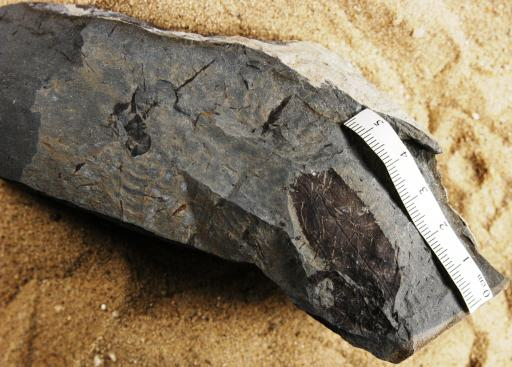
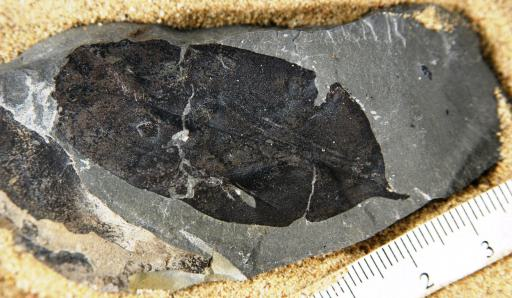
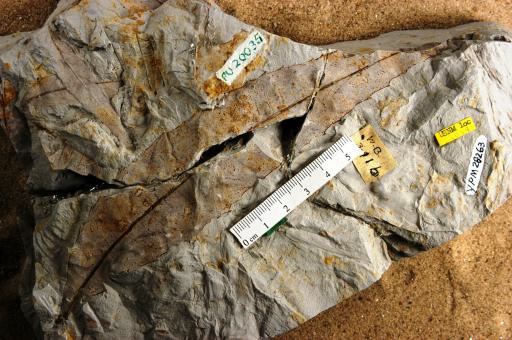
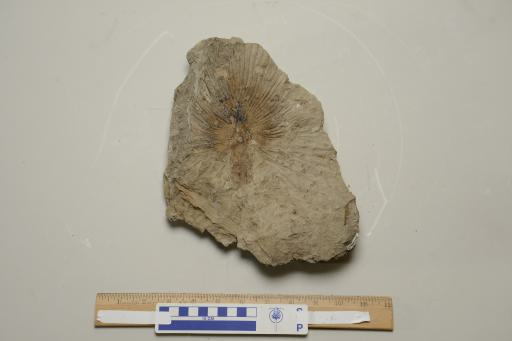
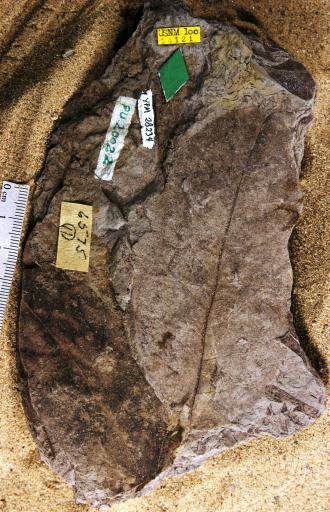
...
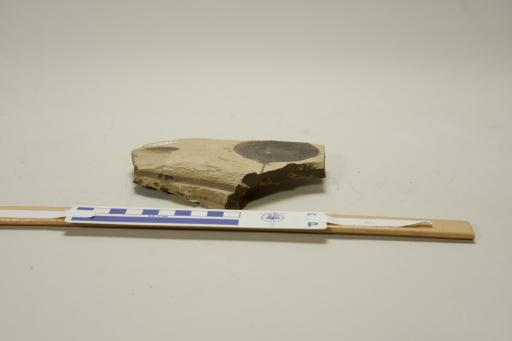
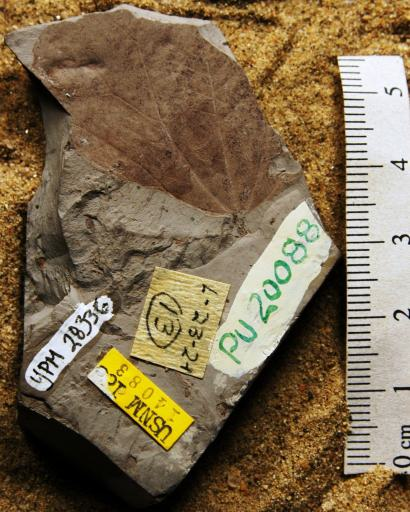
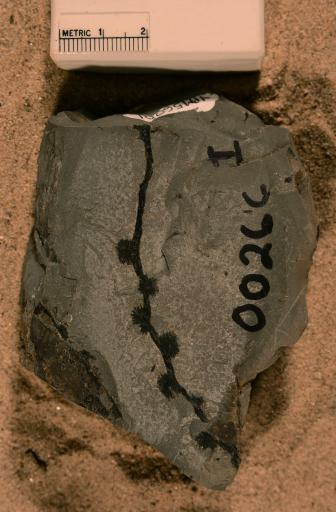
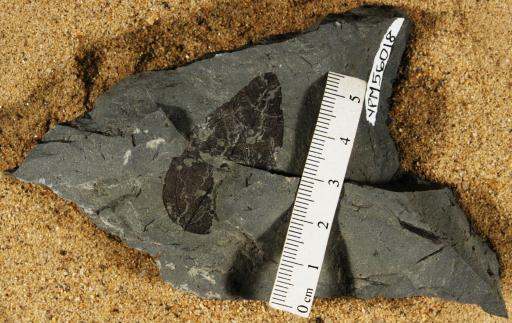
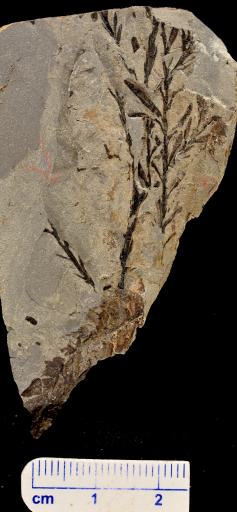

In [66]:
_imgs = mk.ImageColumn.from_filepaths(rb_df[rb_df.recordedBy=="Leo J. Hickey"].thumb_path.values)
_imgs

In [67]:
## 1. Select all rows with `recordedBy` values from contributors with more than thresh # of contributions

# thresh = 1
# labels = rb_df.recordedBy

# vc = labels.value_counts()
# included_labels = vc[vc > thresh].index.values

# valid_recordedBy = rb_df[rb_df.recordedBy.apply(lambda x: x in included_labels)]
# print(f"{rb_df.shape=}, {valid_recordedBy.shape=}")
# print(f"{rb_df.shape[0] - valid_recordedBy.shape[0]=}")

# thresh = 25
# in_thresh = labels.value_counts() >= thresh
# keep_idx = labels.apply(lambda x: in_thresh[x])
# imgs = imgs[keep_idx.index]
# labels = labels[keep_idx]


# label_key = 'country'
# label_key = 'recordedBy'
# imgs, labels = valid_recordedBy.thumb_path, valid_recordedBy.loc[:,label_key]

# assert labels.isna().sum() == 0
#Replace NaN values with string placeholder "NA"
# labels.iloc[labels.isna()] = "NA"

# vc_norm = labels.value_counts(True)
# vc = labels.value_counts()
# pd.concat([vc, vc_norm], axis=1)

# tabs_order = labels.value_counts().index.values

# ipyplot.plot_class_tabs(imgs.values, labels.values, max_imgs_per_tab=50, img_width=200, tabs_order=tabs_order)

* (1:35 AM Monday September 19th, 2022) -- Inspected all `recordedBy` values for contributors with < 50 included specimens, found no issues except for possible herbarium twigs & stems included in 1 contributor's entries (`Jeffrey B. Doran`)


* (4:29 AM Monday September 19th, 2022) -- Inspected all `recordedBy` values for contributors with >= 50 included specimens (except for `Samuel S. Strong` who contributed the most out of anyone, with a total of `4,774` records), found only 1 problem specimen contributed by `Leo J. Hickey`

### Below, we visualize the specimens selected for possible removal

In [68]:
# marked_for_removal = []

In [69]:
dp = mk.DataPanel.from_pandas(rb_df.sort_values("recordedBy", ascending=False))

_cols = dp.columns
_cols.remove("recordedBy")
dp["thumbnail"] = mk.ImageColumn.from_filepaths(dp["thumb_path"])
dp = dp[["thumbnail", "recordedBy", *_cols]]
# dp

In [70]:
selected = dp[dp["recordedBy"] == "Leo J. Hickey"].lz[22:23]

,thumbnail (ListColumn),recordedBy (PandasSeriesColumn),label (PandasSeriesColumn),thumb_path (PandasSeriesColumn),path (PandasSeriesColumn),r (PandasSeriesColumn),g (PandasSeriesColumn),b (PandasSeriesColumn),h (PandasSeriesColumn),s (PandasSeriesColumn),v (PandasSeriesColumn),height (PandasSeriesColumn),width (PandasSeriesColumn),aspect_ratio (PandasSeriesColumn),kingdom (PandasSeriesColumn),phylum (PandasSeriesColumn),class (PandasSeriesColumn),order (PandasSeriesColumn),family (PandasSeriesColumn),genus (PandasSeriesColumn),specificEpithet (PandasSeriesColumn),taxonRank (PandasSeriesColumn),vernacularName (PandasSeriesColumn),continent (PandasSeriesColumn),country (PandasSeriesColumn),stateProvince (PandasSeriesColumn),county (PandasSeriesColumn),municipality (PandasSeriesColumn),locality (PandasSeriesColumn),higherGeography (PandasSeriesColumn),formation (PandasSeriesColumn),scientificName (PandasSeriesColumn),higherClassification (PandasSeriesColumn),earliestPeriodOrLowestSystem (PandasSeriesColumn),earliestEpochOrLowestSeries (PandasSeriesColumn),earliestAgeOrLowestStage (PandasSeriesColumn),bibliographicCitation (PandasSeriesColumn),references (PandasSeriesColumn),decimalLatitude (PandasSeriesColumn),decimalLongitude (PandasSeriesColumn),coordinateUncertaintyInMeters (PandasSeriesColumn),occurrenceID (PandasSeriesColumn),catalogNumber (PandasSeriesColumn),occurrenceRemarks (PandasSeriesColumn),identifier (PandasSeriesColumn),id (PandasSeriesColumn),modified (PandasSeriesColumn),previousIdentifications (PandasSeriesColumn),georeferencedBy (PandasSeriesColumn),georeferencedDate (PandasSeriesColumn),georeferenceSources (PandasSeriesColumn),dynamicProperties (PandasSeriesColumn),error (PandasSeriesColumn)
0,,Leo J. Hickey,,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:5cf7f609-5eb8-473d-bf88-dc8f2ffff878.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:5cf7f609-5eb8-473d-bf88-dc8f2ffff878.png,213.12,207.36,204.18,4.42,32.38,213.16,2394,5202,0.46,Plantae,Tracheophyta,None,Fagales,Fagaceae,Lithocarpus,sp.,Species,"oaks, chestnuts; angiosperms; tracheophytes; plants",North America,USA,Idaho,Shoshone County,Clarkia,Fossil Bowl,North America; USA; Idaho; Shoshone County; Clarkia,Latah Fm,Lithocarpus sp.,Plantae; Tracheophyta; Rosidae; Fagales; Fagaceae; Quercoideae,Neogene,Middle Miocene,None,Lithocarpus sp. (YPM PB 049087),http://collections.peabody.yale.edu/search/Record/YPM-PB-049087,46.99,-116.27,"1,112.00",urn:uuid:0e4900cc-11b8-4536-86ef-af8aec80e999,YPM PB 049087,leaf of California she oak; PB number 49087; lot count 1,urn:uuid:5cf7f609-5eb8-473d-bf88-dc8f2ffff878,urn:uuid:0e4900cc-11b8-4536-86ef-af8aec80e999,2021-02-03T21:46:40.000Z,Lithocarpus sp.,Dylan Young,8/17/2020,GEOLocate,"{ ""irn"": ""779487"", ""media"": ""118675:5cf7f609-5eb8-473d-bf88-dc8f2ffff878"", ""mm_repository_id"": ""118675"", ""solr_long_lat"": ""-116.271629,46.994146"" }",None

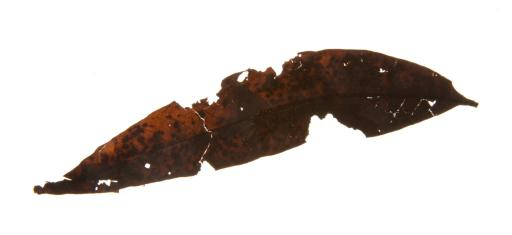

99

100

In [71]:
selected
len(marked_for_removal)

marked_for_removal.append({
    "thumb_path": selected["thumb_path"][0],
    "reason": "Image does not contain a Fossil"
})

len(marked_for_removal)

Some samples contributed by Jeffrey B. Doran were marked as being possibly non-Fossils

,thumbnail (ListColumn),recordedBy (PandasSeriesColumn),label (PandasSeriesColumn),thumb_path (PandasSeriesColumn),path (PandasSeriesColumn),r (PandasSeriesColumn),g (PandasSeriesColumn),b (PandasSeriesColumn),h (PandasSeriesColumn),s (PandasSeriesColumn),v (PandasSeriesColumn),height (PandasSeriesColumn),width (PandasSeriesColumn),aspect_ratio (PandasSeriesColumn),kingdom (PandasSeriesColumn),phylum (PandasSeriesColumn),class (PandasSeriesColumn),order (PandasSeriesColumn),family (PandasSeriesColumn),genus (PandasSeriesColumn),specificEpithet (PandasSeriesColumn),taxonRank (PandasSeriesColumn),vernacularName (PandasSeriesColumn),continent (PandasSeriesColumn),country (PandasSeriesColumn),stateProvince (PandasSeriesColumn),county (PandasSeriesColumn),municipality (PandasSeriesColumn),locality (PandasSeriesColumn),higherGeography (PandasSeriesColumn),formation (PandasSeriesColumn),scientificName (PandasSeriesColumn),higherClassification (PandasSeriesColumn),earliestPeriodOrLowestSystem (PandasSeriesColumn),earliestEpochOrLowestSeries (PandasSeriesColumn),earliestAgeOrLowestStage (PandasSeriesColumn),bibliographicCitation (PandasSeriesColumn),references (PandasSeriesColumn),decimalLatitude (PandasSeriesColumn),decimalLongitude (PandasSeriesColumn),coordinateUncertaintyInMeters (PandasSeriesColumn),occurrenceID (PandasSeriesColumn),catalogNumber (PandasSeriesColumn),occurrenceRemarks (PandasSeriesColumn),identifier (PandasSeriesColumn),id (PandasSeriesColumn),modified (PandasSeriesColumn),previousIdentifications (PandasSeriesColumn),georeferencedBy (PandasSeriesColumn),georeferencedDate (PandasSeriesColumn),georeferenceSources (PandasSeriesColumn),dynamicProperties (PandasSeriesColumn),error (PandasSeriesColumn)
0,,Jeffrey B. Doran,unknown,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:f2c55490-e136-4494-b168-c60b5fd52a3b.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:f2c55490-e136-4494-b168-c60b5fd52a3b.png,249.53,248.63,247.04,6.63,4.53,249.61,3018,4344,0.69,Plantae,Tracheophyta,Trimerophytopsida,None,None,Psilophyton,crenulatum,Species,tracheophytes; plants,North America,Canada,Quebec,Gaspe East County,Gaspe Bay,None,North America; Canada; Quebec; Gaspe East County; Gaspe Bay,Battery Point Fm,Psilophyton crenulatum,Plantae; Tracheophyta; Trimerophytopsida,late early Devonian,None,None,Psilophyton crenulatum (YPM PB 006022),http://collections.peabody.yale.edu/search/Record/YPM-PB-006022,48.77,-64.28,"12,249.00",urn:uuid:2e833c80-1979-4e78-8b0b-eb680498742f,YPM PB 006022,mounted in Ward's Bioplastic; PB number 6022; lot count 1; accn=YPM.07522,urn:uuid:f2c55490-e136-4494-b168-c60b5fd52a3b,urn:uuid:2e833c80-1979-4e78-8b0b-eb680498742f,2022-04-03T21:48:43.000Z,Psilophyton crenulatum,Isabelle M. Carson,3/9/2017,GEOLocate,"{ ""irn"": ""745053"", ""media"": ""118629:f2c55490-e136-4494-b168-c60b5fd52a3b"", ""mm_repository_id"": ""118629"", ""solr_long_lat"": ""-64.281706,48.768948"" }",None
1,,Jeffrey B. Doran,,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:2d352fb8-8620-4f98-82bd-75d16a394294.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:2d352fb8-8620-4f98-82bd-75d16a394294.png,219.25,207.67,173.34,32.28,57.66,219.36,4000,5008,0.80,Plantae,Tracheophyta,Trimerophytopsida,None,None,Psilophyton,crenulatum,Species,tracheophytes; plants,North America,Canada,Quebec,Gaspe East County,Gaspe Bay,None,North America; Canada; Quebec; Gaspe East County; Gaspe Bay,Battery Point Fm,Psilophyton crenulatum,Plantae; Tracheophyta; Trimerophytopsida,late early Devonian,None,None,Psilophyton crenulatum (YPM PB 006024),http://collections.peabody.yale.edu/search/Record/YPM-PB-006024,48.77,-64.28,"12,249.00",urn:uuid:bc95a7ae-73b3-42c6-9b45-fa6f36f78d8e,YPM PB 006024,mounted in Ward's Bioplastic; PB number 6024; lot count 1; accn=YPM.07522,urn:uuid:2d352fb8-8620-4f98-82bd-75d16a394294,urn:uuid:bc95a7ae-73b3-42c6-9b45-fa6f36f78d8e,2022-05-26T21:47:38.000Z,Psilophyton crenulatum,
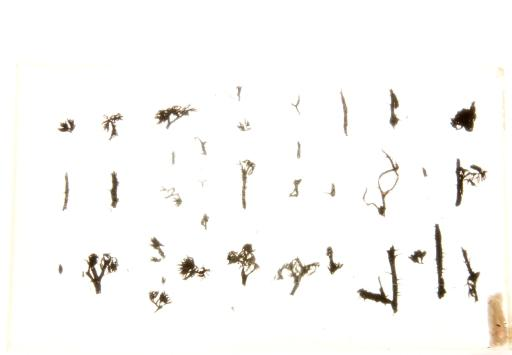
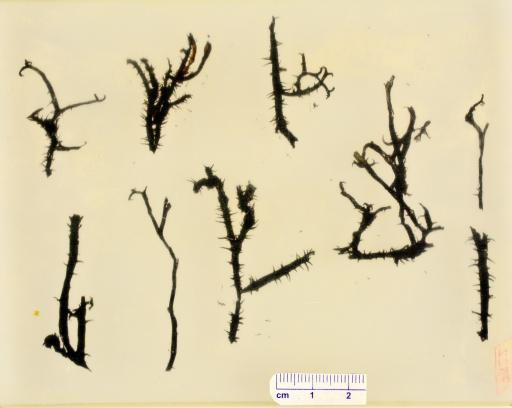
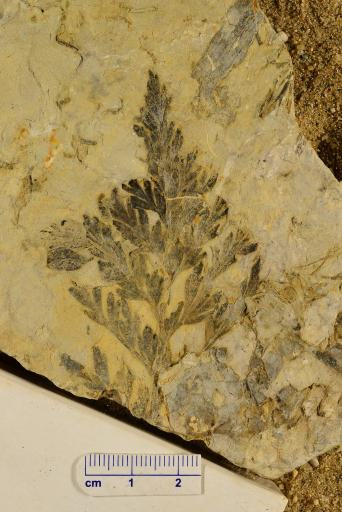
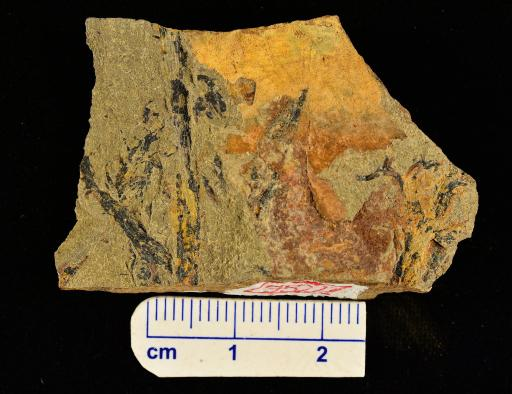
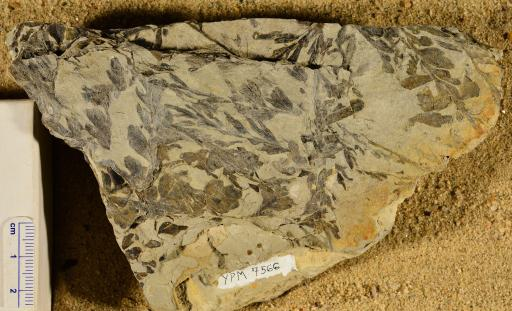
...
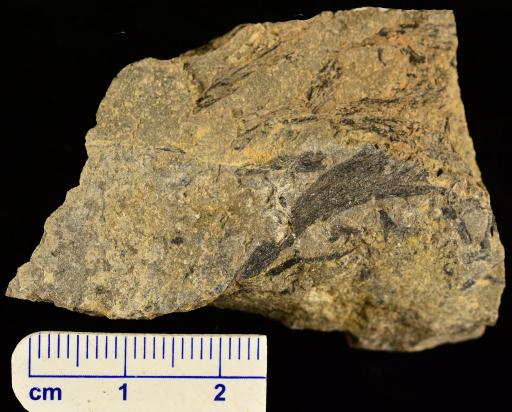
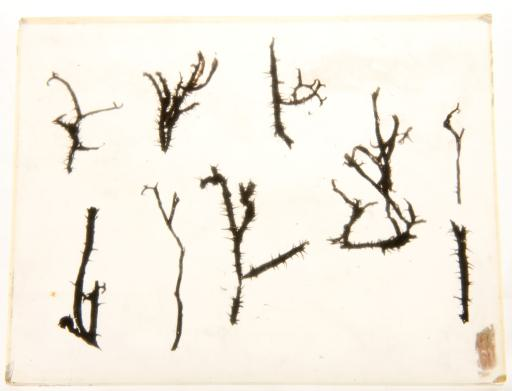
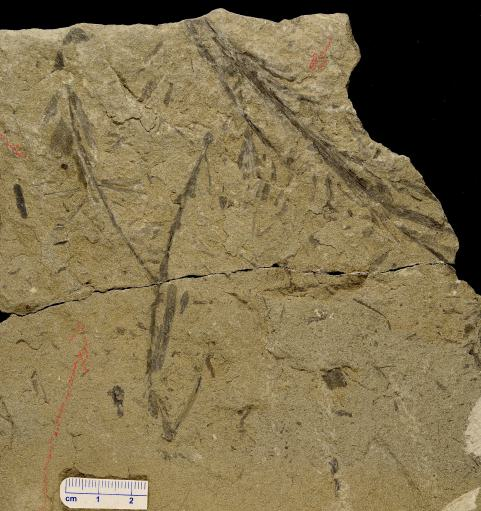
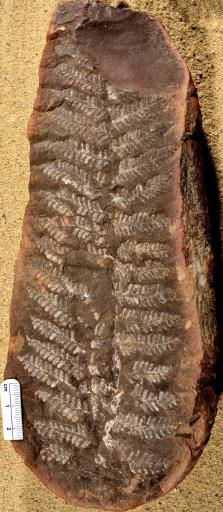
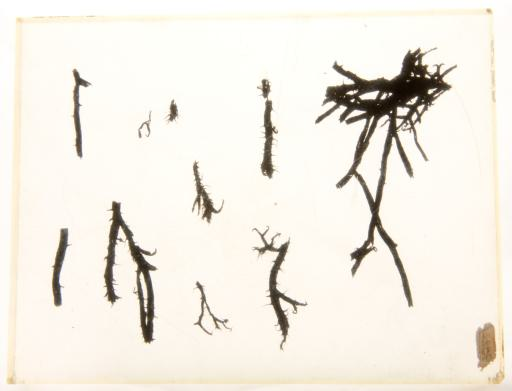

In [72]:
selected = dp[dp["recordedBy"] == "Jeffrey B. Doran"]# .lz[22:23]
selected

Based on visual inspection of this small subset (19 rows), it becomes clear that simply sorting the subset in order of increasing value for `v` column (`value` in HSV image color formats) allows us to cleanly divide into 2 categories, valid vs. invalid specimens 

In [73]:
selected = selected.sort(by="v") 
#[selected.columns[:5]]

to_remove_dp = selected[12:]
to_keep_dp = selected[:12]

In [74]:
marked_for_removal.extend(
    [
        {
            "thumb_path": path,
            "reason": "Image does not contain a Fossil, but what appears to be a collection of stems or roots on bright white backgrounds."
        }
        for path in to_remove_dp["thumb_path"].to_pandas().values.tolist()
    ]
)
# marked_for_removal

len(rb_df)
len(marked_for_removal)
len(rb_df) - len(marked_for_removal)

16444

107

16337

In [75]:
rb_df.describe(include='all')

,label,thumb_path,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,16444,16444,16444,"16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00","16,444.00",16403,15511,5009,13927,9099,15439,14311,16403,16403,13936,13981,13331,12236,12102,5917,13981,10840,16443,16403,13428,7261,8314,16444,16444,"13,842.00","13,842.00","13,758.00",16444,16444,16444,12310,16444,16444,16444,16403,13002,13755,13775,16444,4
unique,4,16444,16444,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,14,26,87,197,663,1313,11,84,5,31,62,191,358,372,483,115,2065,286,55,43,65,15158,15158,NaN,NaN,NaN,15158,15158,13060,195,16444,15158,2146,2126,8,102,5,15158,2
top,,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:38886010-8e7d-499e-b174-0faab01262aa.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:6baf59a9-d48d-4838-8886-28d9a59499d9.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Lycopsida,Marattiales,Calamitaceae,Pecopteris,sp.,Species,tracheophytes; plants,North America,USA,Illinois,Grundy County,Mazon Creek,Woodbridge Clay; Amboy Clays,North America; USA; Illinois; Grundy County; Mazon Creek,Carbondale Fm,Pecopteris sp.,Plantae; Tracheophyta; Marattiales,Middle Pennsylvanian,Carboniferous,Desmoinesian,Calamites sp. (YPM PB 045160),http://collections.peabody.yale.edu/search/Record/YPM-PB-000678,NaN,NaN,NaN,urn:uuid:a44ec069-393d-441f-92af-b1ecd47c4830,YPM PB 045160,leaf; PB number 73504; lot count 1; accn=YPM.10426,Samuel S. Strong,urn:uuid:e221942e-556d-4e7f-8d70-ee69e3462b9e,urn:uuid:a44ec069-393d-441f-92af-b1ecd47c4830,2020-10-03T14:18:59.000Z,Pecopteris sp.,Dylan Young,2/4/2015,GEOLocate,"{ ""irn"": ""776237"", ""media"": ""409264:8464818a-9ff6-4195-a51f-41f249b977c3 409265:f88ea17f-2487-4666-be94-483bf8a037ad 531544:f745f5a3-4e67-45e1-8aa4-066fd1f02b95 531545:2a545f8d-2af1-420a-b1d2-2cb77b3a327f 846738:32fd5fa7-b260-4174-8f85-ce6d554ca0e3"", ""mm_repository_id"": ""409264"", ""original_num"": ""NYBG 8807 G"" }",image file is truncated (0 bytes not processed)
freq,16209,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16369,15395,1745,4210,1720,4167,6447,14120,10825,13256,12848,4895,4857,4842,423,4842,4856,3541,4194,5036,4604,4849,5,5,NaN,NaN,NaN,5,5,6,4774,1,5,5202,3523,11877,4886,13679,5,3
mean,NaN,NaN,NaN,139.91,113.34,80.43,31.61,117.67,140.32,"2,676.11","2,876.15",1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.74,-87.61,"22,915.37",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,36.26,35.27,37.16,18.28,45.56,36.45,"1,087.97","1,198.44",0.44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.07,24.39,"137,592.11",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,18.64,18.24,9.78,4.31,4.36,19.68,198.00,284.00,0.11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-49.05,-151.53,80.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,116.13,90.47,56.28,21.89,87.46,116.48,"1,988.00","2,053.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.48,-98.20,"2,929.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,141.51,111.54,72.13,25.40,125.38,141.89,"2,612.00","2,990.00",0.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [76]:
# marked_for_removal[0]["thumb_path"] = marked_for_removal[0]["thumb_path"][0]

In [77]:
marked_for_removal_dict = {}
for k in marked_for_removal[0].keys():
    marked_for_removal_dict[k] = [i[k] for i in marked_for_removal]
    
len(marked_for_removal_dict)
    

2

In [80]:
removal_df = pd.DataFrame.from_records(marked_for_removal)

removal_df = (
    removal_df
    .merge(rb_df, on="thumb_path")
    .rename(columns={"reason":"reason_removed"})
    .drop(columns=["label"])
)
# removal_df
assert removal_df.shape == (107,52)

ids2remove = removal_df.identifier.values.tolist()

# rb_df[rb_df.identifier.apply(lambda x: x in ids2remove)].shape

In [82]:
removal_df.describe(include='all')

,thumb_path,reason_removed,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,107,107,107,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107,103,13,77,100,107,107,107,107,9,9,8,8,8,1,9,8,107,107,9,1,0,107,107,8.00,8.00,8.00,107,107,107,8,107,107,107,107,8,8,8,107,0
unique,107,3,107,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1,3,27,65,73,83,1,26,2,3,2,2,2,1,3,2,84,69,3,1,0,104,104,NaN,NaN,NaN,104,104,104,2,107,104,14,84,2,2,1,104,0
top,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:f76a93e7-5c48-4382-9508-6706d24ffc93.jpg,"Specimen image appears not to be a Fossil, found by manual inspection after filtering for rows with NaN values in `recordedBy`, then rows with NaN values in `country`, then sorting by `v`",/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:2a839ca2-dac5-4b7e-a2a0-9dc0b4c405ca.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Trimerophytopsida,Caryophyllales,Campanulaceae,Psilophyton,crenulatum,Species,angiosperms; tracheophytes; plants,North America,Canada,Quebec,Gaspe East County,Gaspe Bay,Fossil Bowl,North America; Canada; Quebec; Gaspe East County; Gaspe Bay,Battery Point Fm,Psilophyton crenulatum,Plantae; Tracheophyta; Trimerophytopsida,late early Devonian,Middle Miocene,NaN,Psilophyton crenulatum (YPM PB 006023),http://collections.peabody.yale.edu/search/Record/YPM-PB-006024,NaN,NaN,NaN,urn:uuid:c829704e-134a-41f4-9bc7-c657e6bc9f47,YPM PB 006023,mounted in Ward's Bioplastic; PB number 6025; lot count 1; accn=YPM.07522,Jeffrey B. Doran,urn:uuid:6e3c9fcb-fae4-42f5-ba13-6500b6c2a425,urn:uuid:c829704e-134a-41f4-9bc7-c657e6bc9f47,2015-12-01T12:29:21.000Z,Psilophyton crenulatum,Isabelle M. Carson,3/9/2017,GEOLocate,"{ ""irn"": ""745054"", ""media"": ""118630:28be843b-8b5f-424f-9f01-f1422b3ebce6 961307:830b0856-d490-4652-91c0-f3eed1d14bf5"", ""mm_repository_id"": ""118630"", ""solr_long_lat"": ""-64.281706,48.768948"" }",NaN
freq,1,98,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,107,103,7,13,8,7,7,107,53,8,7,7,7,7,1,7,7,7,7,7,1,NaN,2,2,NaN,NaN,NaN,2,2,2,7,1,2,43,7,7,7,8,2,NaN
mean,NaN,NaN,NaN,210.70,215.41,188.89,68.84,48.66,224.47,"7,039.01","9,420.40",0.76,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.55,-70.78,"10,856.88",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,17.13,24.05,25.48,24.03,20.19,19.11,"2,066.94","2,735.10",0.14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.63,18.38,"3,937.52",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,112.00,101.38,87.15,4.42,4.53,112.08,"1,399.00","1,401.00",0.33,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,46.99,-116.27,"1,112.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,203.71,207.65,183.76,64.77,37.80,219.02,"8,000.00","10,688.00",0.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.77,-64.28,"12,249.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,210.56,220.44,190.84,70.67,44.69,225.98,"8,000.00","10,688.00",0.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.77,-64.28,"12,249.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,219.15,230.36,200.36,80.64,53.72,237.66,"8,000.00","10,688.00",0.75,NaN,NaN,

In [81]:
final_df2keep = rb_df[rb_df.identifier.apply(lambda x: x not in ids2remove)]

final_df2keep = (
    final_df2keep.drop(columns=["label"])
)
assert final_df2keep.shape == (16337,51)

final_df2keep.describe(include='all')

,thumb_path,path,r,g,b,h,s,v,height,width,aspect_ratio,kingdom,phylum,class,order,family,genus,specificEpithet,taxonRank,vernacularName,continent,country,stateProvince,county,municipality,locality,higherGeography,formation,scientificName,higherClassification,earliestPeriodOrLowestSystem,earliestEpochOrLowestSeries,earliestAgeOrLowestStage,bibliographicCitation,references,decimalLatitude,decimalLongitude,coordinateUncertaintyInMeters,occurrenceID,catalogNumber,occurrenceRemarks,recordedBy,identifier,id,modified,previousIdentifications,georeferencedBy,georeferencedDate,georeferenceSources,dynamicProperties,error
count,16337,16337,"16,337.00","16,337.00","16,337.00","16,337.00","16,337.00","16,337.00","16,337.00","16,337.00","16,337.00",16296,15408,4996,13850,8999,15332,14204,16296,16296,13927,13972,13323,12228,12094,5916,13972,10832,16336,16296,13419,7260,8314,16337,16337,"13,834.00","13,834.00","13,750.00",16337,16337,16337,12302,16337,16337,16337,16296,12994,13747,13767,16337,4
unique,16337,16337,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,14,26,83,153,602,1251,11,73,5,30,61,190,357,371,481,114,1989,239,55,42,65,15054,15054,NaN,NaN,NaN,15054,15054,12956,195,16337,15054,2141,2050,8,102,5,15054,2
top,/dev/shm/jrose3/2022-yale_fossils/image_thumbnails/res=512/urn:uuid:38886010-8e7d-499e-b174-0faab01262aa.jpg,/media/data_cifs/projects/prj_fossils/data/yale_full/urn:uuid:6baf59a9-d48d-4838-8886-28d9a59499d9.png,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Plantae,Tracheophyta,Lycopsida,Marattiales,Calamitaceae,Pecopteris,sp.,Species,tracheophytes; plants,North America,USA,Illinois,Grundy County,Mazon Creek,Woodbridge Clay; Amboy Clays,North America; USA; Illinois; Grundy County; Mazon Creek,Carbondale Fm,Pecopteris sp.,Plantae; Tracheophyta; Marattiales,Middle Pennsylvanian,Carboniferous,Desmoinesian,Annularia sphenophylloides (YPM PB 003129),http://collections.peabody.yale.edu/search/Record/YPM-PB-012698,NaN,NaN,NaN,urn:uuid:585089e7-973b-4721-aa03-521bda94f591,YPM PB 000678,leaf; PB number 73504; lot count 1; accn=YPM.10426,Samuel S. Strong,urn:uuid:e221942e-556d-4e7f-8d70-ee69e3462b9e,urn:uuid:585089e7-973b-4721-aa03-521bda94f591,2020-10-03T14:18:59.000Z,Pecopteris sp.,Dylan Young,2/4/2015,GEOLocate,"{ ""irn"": ""738576"", ""media"": ""409243:87c656ad-ac16-4d0c-a3db-8ef31d5785c4 409244:1d95fc39-73cc-4e48-b302-23db440e3103 531497:8f24a4e7-add9-48d2-90f5-30691dee0d6a 531498:4de61ab7-9025-4fbf-946d-ec0c9ed25cf6 840794:7be84dbb-d7c4-4b98-a574-7d6f88c4e49d"", ""mm_repository_id"": ""409243"" }",image file is truncated (0 bytes not processed)
freq,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16262,15292,1745,4210,1720,4167,6446,14013,10807,13248,12847,4895,4857,4842,423,4842,4856,3541,4194,5036,4604,4849,5,5,NaN,NaN,NaN,5,5,6,4774,1,5,5202,3523,11876,4886,13671,5,3
mean,NaN,NaN,139.44,112.67,79.72,31.37,118.12,139.77,"2,647.54","2,833.28",1.01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.74,-87.62,"22,922.38",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,35.89,34.35,36.17,17.99,45.33,35.89,"1,018.93","1,055.83",0.44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.07,24.39,"137,631.80",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,18.64,18.24,9.78,4.31,4.36,19.68,198.00,284.00,0.11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-49.05,-151.53,80.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,115.95,90.25,56.18,21.88,88.28,116.29,"1,988.00","2,045.00",0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.48,-98.20,"2,929.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,141.17,111.37,71.93,25.35,125.72,141.58,"2,602.00","2,990.00",0.86,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.29,-88.42,"11,866.00",NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

# III. Save Versions 0 (inputs to this notebook) and 1 (outputs of this notebook) as csv catalogs for sharing with others

In [135]:
# save_dir = Path('/media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/official_releases/version_0')
save_dir = Path("/media/data_cifs/projects/prj_fossils/data/raw_data/2022-yale_fossil/official_releases/version_0")
os.makedirs(save_dir, exist_ok=True)

rb_df.to_csv(Path(save_dir, "original_catalog.csv"))

with open(Path(save_dir, "README.md"), "w") as f:
    f.write(
        """
# 2022 yale fossil dataset
## version 0

Created on: Monday Sept 19th, 2022  
Created by: Jacob A Rose, working on data provided by Peter Wilf  

Contains a total of `16,444` specimens without removing any of the many duplicates and non-Fossil images.  
See versions 1+ for cleaner versions of thhe catalog.
        """
           )


317

In [136]:
# save_dir = Path('/media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/official_releases/version_1')
save_dir = Path("/media/data_cifs/projects/prj_fossils/data/raw_data/2022-yale_fossil/official_releases/version_1")
os.makedirs(save_dir, exist_ok=True)

save_dir

In [140]:
# removal_df.to_pandas().drop(columns=["thumbnail"]).to_csv(Path(save_dir, "catalog_marked_for_removal.csv"))

removal_df.to_csv(Path(save_dir, "catalog_marked_for_removal.csv"))
final_df2keep.to_csv(Path(save_dir, "catalog_marked_to_keep.csv"))

removal_df.to_parquet(Path(save_dir, "catalog_marked_for_removal.parquet"))
final_df2keep.to_parquet(Path(save_dir, "catalog_marked_to_keep.parquet"))

with open(Path(save_dir, "README.md"), "w") as f:
    f.write(
        f"""
# 2022 yale fossil dataset
## version 1

Created on: Monday Sept 19th, 2022  
Created by: Jacob A Rose, working on data provided by Peter Wilf  

Contains 2 separate catalogs containing respectively:  
1. `catalog_marked_for_removal`: `{removal_df.shape[0]}` specimens for removal, and  
2. `catalog_marked_to_keep`: `{final_df2keep.shape[0]}` specimens for keeping  

from an original total of `16,444` specimens.  

------------  
* The `catalog_marked_for_removal` contains an extra column describing the reason for removal  
* Version 2 will deal with removing the still included sequence of duplicate images
        """
           )


585

In [ ]:
# mark_for_inspection = {"recordedBy":
#                            ["Jeffrey B. Doran"]
#                       }

# End

* Previous skeleton code for implementing a PigeonXT-based image annotation workflow

In [ ]:
dp = mk.DataPanel.from_pandas(rb_df.sort_values("recordedBy", ascending=False))

# annotated_dp["thumb_path"].describe(include='all')
# annotated_dp = annotated_dp.update(thumbnail = mk.ImageColumn(annotated_dp["thumb_path"]))
# annotated_dp
_cols = dp.columns
_cols.remove("recordedBy")
dp["thumbnail"] = mk.ImageColumn.from_filepaths(dp["thumb_path"])
dp = dp[["thumbnail", "recordedBy", *_cols]]
dp

no_recorded_by = dp.to_pandas()["recordedBy"].isna()
no_recorded_by.sum()

no_recorded_by_idx = no_recorded_by.index[no_recorded_by]

has_recorded_by_idx = no_recorded_by.index[~no_recorded_by]

In [ ]:
dp.lz[has_recorded_by_idx.values]

## Dataset partition -- MVP version 1 -- Classify between records with NaN values in `recordedBy` column and those with a valid str.

In [ ]:
has_recorded_by_dp = dp.lz[has_recorded_by_idx.values]
no_recorded_by_dp = dp.lz[no_recorded_by_idx.values]

In [ ]:
has_recorded_by_df = has_recorded_by_dp.to_pandas() 
has_recorded_by_df[has_recorded_by_df["references"].isna()]

# no_recorded_by_dp["label"] = "unknown"

In [ ]:
no_recorded_by_df = no_recorded_by_dp.to_pandas() 
no_recorded_by_df[no_recorded_by_df["references"].isna()]

# no_recorded_by_dp["label"] = "unknown"

In [ ]:
# has_recorded_by_dp.sort(by="v", ascending=False)
no_recorded_by_dp.sort(by="v", ascending=False)

In [ ]:
has_recorded_by_dp.sort(by="v", ascending=False)
# no_recorded_by_dp["label"] = "unknown"

In [ ]:
has_recorded_by_dp.to_pandas().drop(columns=["thumbnail"]).to_csv(Path(save_dir, "class_0_has-recordedBy.csv"))
no_recorded_by_dp.to_pandas().drop(columns=["thumbnail"]).to_csv(Path(save_dir, "class_1_no-recordedBy.csv"))

has_recorded_by_dp.to_pandas().drop(columns=["thumbnail"]).to_parquet(Path(save_dir, "class_0_has-recordedBy.parquet"))
no_recorded_by_dp.to_pandas().drop(columns=["thumbnail"]).to_parquet(Path(save_dir, "class_1_no-recordedBy.parquet"))

print(f"{save_dir=}")
pp(os.listdir(save_dir))

In [ ]:
sns.histplot(df, x='locality', kde=True)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# plt.figure(figsize=(30,10))
# g = sns.FacetGrid(ddf, col='vernacularName') #,
fig, ax = plt.subplots(1,1, figsize=(30,10))
sns.histplot(ddf, x='vernacularName', y='r', color='red', bins=10, ax=ax)
sns.histplot(ddf, x='vernacularName', y='g', color='green', bins=10, ax=ax)
sns.histplot(ddf, x='vernacularName', y='b', color='blue', bins=10, ax=ax)
# g.map(sns.scatterplot, 'family', 'r', alpha=0.5)
g.set(ylim=(750, -10));

ddf.value_counts('vernacularName')


# plt.figure(figsize=(30,10))
g = sns.FacetGrid(ddf, col='vernacularName') #, figsize=(30,10))
g.map(sns.histplot, 'order', 'r', bins=10)#, alpha=0.5)
# g.map(sns.scatterplot, 'family', 'r', alpha=0.5)
g.set(ylim=(750, -10));


In [ ]:
annotations = pixt.annotate(
    df,
    example_column = "thumb_path",
    id_column = "idx",
    value_column = "label",
    options=options,
    additional_columns=[*stats_cols[3:], *geo_cols[3:]],
    display_fn=lambda filename: display_fn(filename, width=400)
    # display_fn=lambda filename: Image(filename)
    # display_fn=lambda filename: display(Image(filename))
)


# import pandas as pd
# import pigeonXT as pixt

# from IPython.display import display, Image

# annotations = pixt.annotate(
#     dp,
#     show_columns="stats_cols",
#     annotation_column_name="thumb_path",
#     options=[
#         'Fossil Leaf', 'Cleared Leaf', 'unknown'
#     ],
#     display_fn=lambda filename: display(Image(filename))
# )

all_annotations = pd.concat([annotated_df,
                             annotations])

all_annotations.value_counts("label")

In [ ]:
all_annotations[all_annotations.label=="unknown"].value_counts("stateProvince")

In [ ]:
all_annotations[all_annotations.label=="unknown"].value_counts("recordedBy")

In [ ]:
import meerkat as mk
# display_res = 1024
# print(mk.config.DisplayOptions.max_image_width)
# mk.config.display.max_rows = 100
# mk.config.display.max_image_width = display_res
# mk.config.display.max_image_height = display_res

# mk.config.DisplayOptions.max_rows = 100
# mk.config.DisplayOptions.max_image_width = display_res
# mk.config.DisplayOptions.max_image_height = display_res

# print(f"{mk.config.DisplayOptions.max_image_width=}")
print("mk.config.display=")
pp(dict(vars(mk.config.display)))


In [ ]:
df2scrutinize = all_annotations[all_annotations.label=="unknown"]

annotated_dp = mk.DataPanel.from_pandas(df2scrutinize.sort_values("label", ascending=False))

# annotated_dp["thumb_path"].describe(include='all')
# annotated_dp = annotated_dp.update(thumbnail = mk.ImageColumn(annotated_dp["thumb_path"]))
# annotated_dp

annotated_dp["thumbnail"] = mk.ImageColumn.from_filepaths(annotated_dp["thumb_path"])
annotated_dp = annotated_dp[["label", "thumbnail", *cols]]
annotated_dp

In [ ]:
from embetter import grab

In [ ]:
# Helpers to grab text or image from pandas column.
from embetter.grab import ColumnGrabber, ImageGrabber
# Representations for computer vision
from embetter.vision import TorchVision

In [ ]:
from sklearn.pipeline import make_pipeline 
from sklearn.linear_model import LogisticRegression

# This pipeline grabs the `img_path` column from a dataframe
# then it grabs the image paths and turns them into `PIL.Image` objects
# which then get fed into MobileNetv2 via TorchVision.
image_emb_pipeline = make_pipeline(
  ColumnGrabber("thumb_path"),
  ImageGrabber(convert="RGB"),
  TorchVision("pytorch/vision", "mobilenet_v2", "MobileNet_V2_Weights.IMAGENET1K_V2")
)

In [ ]:
# This pipeline can also be trained to make predictions, using
# the embedded features. 
image_clf_pipeline = make_pipeline(
  image_emb_pipeline,
  LogisticRegression()
)

In [ ]:
import skprog

In [ ]:
from skprog.wrappers import GLMProgressor

In [ ]:
annotated_df.columns

dir(image_clf_pipeline)

dir(image_emb_pipeline)

dir(image_clf_pipeline.steps[1][1])

In [ ]:
image_emb_pipeline.get_params

In [ ]:
%%time

print(f"{annotated_df.shape=}")
# image_emb_pipeline.fit_transform(annotated_df, annotated_df['label'])
image_clf_pipeline = image_clf_pipeline.fit(annotated_df, annotated_df['label'])

In [ ]:
%%time
from tqdm.auto import tqdm

preds = image_clf_pipeline.predict(tqdm(annotated_df))#, annotated_df['label'])



In [ ]:
# annotations.sort_values("label", ascending=False)
for i, r in annotations.groupby("label"):
    print(i)
    r

annotations.value_counts("label")

## Create mk.DataPanel to inspect new annotations

In [ ]:
annotated_dp = mk.DataPanel.from_pandas(annotations.sort_values("label", ascending=False))

# annotated_dp["thumb_path"].describe(include='all')
# annotated_dp = annotated_dp.update(thumbnail = mk.ImageColumn(annotated_dp["thumb_path"]))
# annotated_dp

annotated_dp["thumbnail"] = mk.ImageColumn.from_filepaths(annotated_dp["thumb_path"])
annotated_dp = annotated_dp[["label", *cols]]

### Save dataframe containing most up to date partitions between annotationed samples & those that have yet to be

* Note: Need to standardize this so it automatically loads the last version's annotations at the top of the script.

In [ ]:
all_annotations_df = (
    annotated_dp
    .to_pandas()
    .drop(columns=["thumbnail"])
)    
annotated_df = all_annotations_df[all_annotations_df.label != '']
non_annotated_df = all_annotations_df[all_annotations_df.label == '']


In [ ]:
# annotations_dir = "/media/data_cifs/projects/prj_fossils/users/jacob/github/image-utils/notebooks/fossil dataset preprocessing/2022-yale_fossil/manual_annotations"
# save_dir = get_latest_version(root_dir=annotations_dir)
# print(f"Saving annotations in {save_dir}")

# cache_annotations(save_dir=save_dir,
#                   annotated_df=annotated_df,
#                   non_annotated_df=non_annotated_df)


# # annotated_df, non_annotated_df = load_cached_annotations(save_dir=save_dir)

In [ ]:
# !pip3 install mplcyberpunk


In [ ]:
# label = "Fossil Leaf"

# df = annotated_subset[annotated_subset.label == label]

# image_paths = df.thumb_path.values.tolist()
# n = len(image_paths)
# # image_paths = image_paths[:20]

# fig = image_grid(image_paths, col=8, max_imgs=24)
# plt.suptitle(f"{label=}, {n=}", fontsize=16, fontweight='bold')
# #################################
# label = "Cleared Leaf"

# df = annotated_subset[annotated_subset.label == label]

# image_paths = df.thumb_path.values.tolist()
# n = len(image_paths)
# # image_paths = image_paths[:20]

# fig = image_grid(image_paths, col=8, max_imgs=24)
# plt.suptitle(f"{label=}, {n=}", fontsize=16, fontweight='bold')

# geo_cols


# for i, d in annotated_subset[["label", *geo_cols]].groupby("label"):
#     print(f"label={i}")
#     d.value_counts("country")

# annotated_subset.groupby("label")["family"].value_counts()

## Plotting sample pages of labeled & unlabeled images

In [ ]:

import matplotlib.pyplot as plt
import mplcyberpunk
plt.style.use("cyberpunk")

In [ ]:
%%time

max_imgs = 124
label = "unknown"
label_dir = Path(save_dir, label)
os.makedirs(label_dir)


df = annotated_subset[annotated_subset.label == label]
df = df.drop(columns=["thumbnail"])

image_paths = df.thumb_path.values.tolist()
n = len(image_paths)

title = f"{label=},{n=}"

fig = image_grid(image_paths, col=8, max_imgs=max_imgs)
plt.suptitle(f"{label=}, {n=}", fontsize=16, fontweight='bold')


plt.savefig(Path(label_dir, f"{title}.jpg"))
df.to_parquet(Path(label_dir, f"{title}.parquet"))
df.to_csv(Path(label_dir, f"{title}.csv"))

In [ ]:
%%time

max_imgs = 124
label = "Fossil Leaf"
label_dir = Path(save_dir, label)
os.makedirs(label_dir)



df = annotated_subset[annotated_subset.label == label]
df = df.drop(columns=["thumbnail"])

image_paths = df.thumb_path.values.tolist()
n = len(image_paths)

title = f"{label=},{n=}"

fig = image_grid(image_paths, col=8, max_imgs=max_imgs)
plt.suptitle(f"{label=}, {n=}", fontsize=16, fontweight='bold')


plt.savefig(Path(label_dir, f"{title}.jpg"))
df.to_parquet(Path(label_dir, f"{title}.parquet"))
df.to_csv(Path(label_dir, f"{title}.csv"))

In [ ]:
%%time

max_imgs = 124
label = "Cleared Leaf"
label_dir = Path(save_dir, label)
os.makedirs(label_dir)



df = annotated_subset[annotated_subset.label == label]
df = df.drop(columns=["thumbnail"])

image_paths = df.thumb_path.values.tolist()
n = len(image_paths)

title = f"{label=},{n=}"

fig = image_grid(image_paths, col=8, max_imgs=max_imgs)
plt.suptitle(f"{label=}, {n=}", fontsize=16, fontweight='bold')


plt.savefig(Path(label_dir, f"{title}.jpg"))
df.to_parquet(Path(label_dir, f"{title}.parquet"))
df.to_csv(Path(label_dir, f"{title}.csv"))


# Scratch

## Misc extra functions

In [ ]:
df = df.sort_values(
    "v",
    ascending=True, # False,
    ignore_index=True
)

df

bins = [0.0, 0.25, 0.5, 0.75, 1.0] #[:-1]

df["quantiles"], o_bins = pd.qcut(
    df["v"],
    len(bins),
    labels=bins,
    precision=2,
    retbins=True
)

df.describe(include="all")

largest_idx = df.groupby("quantiles")["v"].nlargest(10).reset_index(level=0).index
smallest_idx = df.groupby("quantiles")["v"].nsmallest(10).reset_index(level=0).index


largest_idx
smallest_idx

from more_itertools import unzip

smallest = df.loc[smallest_idx,:]
largest = df.loc[largest_idx,:]


i, paths, quantiles, v_list = [
    list(c) for c in unzip(
        smallest[["path", "quantiles", "v"]].to_records()
    )
]


# i, paths, quantiles, v_list = [
#     list(c) for c in unzip(
#         largest[["path", "quantiles", "v"]].to_records()
#     )
# ]


import ipyplot

tabs_order=sorted(set(quantiles))

ipyplot.plot_class_tabs(paths,
                        labels=[f"{q:.2%}" for q in quantiles],
                        custom_texts=[f"{v=}" for v in v_list],
                        tabs_order=np.sort(list(set(quantiles)))
                    )

records = df.to_records()
records

records[0]



In [ ]:
from functools import partial

import pandas as pd
from IPython.core.display import HTML


def generate_file_path_dataframe_fixture() -> pd.DataFrame:
    df = pd.DataFrame(
        [
            [2768571, 130655, 1155027, 34713051, 331002277],
            [1448753, 60632, 790040, 3070447, 212558178],
            [654405, 9536, 422931, 19852167, 145934619],
            [605216, 17848, 359891, 8826585, 1379974505],
            [288477, 9860, 178245, 1699369, 32969875]
        ],
        columns = ['Total Cases', 'Total Deaths', 'Total Recovered', 'Total Tests', 'Population']
    )

    df['Country'] = [
        'https://www.countries-ofthe-world.com/flags-normal/flag-of-United-States-of-America.png',
        'https://www.countries-ofthe-world.com/flags-normal/flag-of-Brazil.png',
        'https://www.countries-ofthe-world.com/flags-normal/flag-of-Russia.png',
        'https://www.countries-ofthe-world.com/flags-normal/flag-of-India.png',
        'https://www.countries-ofthe-world.com/flags-normal/flag-of-Peru.png'
    ]
    return df






def path_to_image_html(path: str,
                       width: int=128):
    return f'<img src="{path}" width="{width}" >'


def display_image_df(df: pd.DataFrame,
                     formatters: Dict[str,Callable]
                    ):
    return HTML(
        df.to_html(
            escape=False,
            formatters=formatters
        )
    )

formatters = {
    "img": 
    partial(
        path_to_image_html#, width-50
    )
}



df_html = display_image_df(
    df=df.assign(img=df.path.values),
    formatters=formatters
)
df_html